**<center><h1>Car Damage Detection</h1></center>**

## **Introduction**

In this notebook, we are going to train a detection model in order to detect the car damage

In [ ]:
# Install libraries
!pip install seedir
!pip install emoji
!pip install plotly

In [ ]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import seedir as sd
from zipfile import ZipFile
import plotly.express as px
import shutil
import cv2
from PIL import Image, ImageDraw
import json
import itertools

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#shutil.rmtree("/content/runs")

In [ ]:
# create a local directory for the dataset
#shutil.rmtree("/content/car_damage_dataset")
os.mkdir("/content/car_damage_dataset")
#os.mkdir("/content/car_damage_dataset/YoloV5_format")
os.mkdir("/content/car_damage_dataset/YoloV8_format")
os.mkdir("/content/car_damage_dataset/YoloV8_format/severe_damage")
os.mkdir("/content/car_damage_dataset/YoloV8_format/severe_damage_augmented")

In [ ]:
def extract_csv(filename, directory_name):
  with ZipFile(filename, 'r') as zipObj:
    # Extract all the contents of zip file in different directory
    zipObj.extractall(directory_name)

In [ ]:
# extract stanford cars dataset into a local directory
#extract_csv("/content/drive/MyDrive/GT-AI: Datasets+Notebooks/Datasets/Cars/Computer Vision/Car_damage/Cars_damage_YoloV5_format.zip", "/content/car_damage_dataset/YoloV5_format")
#extract_csv("/content/drive/MyDrive/GT-AI: Datasets+Notebooks/Datasets/Cars/Computer Vision/Car_damage/car_damage_instance_segmentation.zip", "/content/car_damage_dataset/YoloV8_format")
extract_csv("/content/drive/MyDrive/GT-AI: Datasets+Notebooks/Datasets/Cars/Computer Vision/Car_damage/Damage Severity.v1i.yolov8.zip", "/content/car_damage_dataset/YoloV8_format/severe_damage")

In [ ]:
extract_csv("/content/drive/MyDrive/GT-AI: Datasets+Notebooks/Datasets/Cars/Computer Vision/Car_damage/car_damage_severity.v3i.yolov8.zip", "/content/car_damage_dataset/YoloV8_format/severe_damage_augmented")

In [ ]:
sd.seedir('/content/car_damage_dataset', itemlimit=5)

car_damage_dataset/
└─YoloV8_format/
  ├─severe_damage/
  │ ├─valid/
  │ │ ├─labels/
  │ │ │ ├─39_jpg.rf.fb6afee8880b501e262b57250caaafd0.txt
  │ │ │ ├─crashed194_jpg.rf.6e100118e3bec3b6587a3877b8719d53.txt
  │ │ │ ├─Img213_jpg.rf.87dc4016ccb62152496a31aae09f2ff6.txt
  │ │ │ ├─0581_JPEG_jpg.rf.adb6ec96a14913a0ce18d543676cc4a3.txt
  │ │ │ └─25_jpg.rf.16f9dcd205b2d280fb4a1e8b59c2405d.txt
  │ │ └─images/
  │ │   ├─lamp-broken392_jpg.rf.def94e73aa211dd40146b627e8a7c6e6.jpg
  │ │   ├─54_jpg.rf.cc3b8120a045ac1b28d3796d174e9a38.jpg
  │ │   ├─crashed176_jpg.rf.57fe686cb2ba39fbf73296c387518a03.jpg
  │ │   ├─Img443_jpg.rf.cf520edfef18f6afd1d163024c689983.jpg
  │ │   └─lamp-broken159_jpg.rf.6520500936f955f86517a32c9c0dc44d.jpg
  │ ├─README.roboflow.txt
  │ ├─data.yaml
  │ ├─test/
  │ │ ├─labels/
  │ │ │ ├─scratch192_jpg.rf.e0406829822b42701f6f8679e38a8306.txt
  │ │ │ ├─glass185_jpg.rf.435a8382c3182d5f6308b2beb868f8f8.txt
  │ │ │ ├─glass54_jpg.rf.6f8ee68f5bc5e9d44f2d8ec91d6fa7d0.txt
  │ │ │ ├─66_j

In [ ]:
os.chdir("/content")

## **Modeling**

let's start by training yolov8

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [ ]:
!pip install ultralytics==8.0.20

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.20 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 24.3/78.2 GB disk)


In [ ]:
from ultralytics import YOLO

from IPython.display import display, Image

In [ ]:
"""%cd {HOME}

!yolo task=segment mode=train model=yolov8m-seg.pt data=car_damage_dataset/YoloV8_format/severe_damage/data.yaml epochs=150 imgsz=640"""

'%cd {HOME}\n\n!yolo task=segment mode=train model=yolov8m-seg.pt data=car_damage_dataset/YoloV8_format/severe_damage/data.yaml epochs=150 imgsz=640'

In [ ]:
%cd {HOME}

!yolo task=segment mode=train model=yolov8s-seg.pt data=car_damage_dataset/YoloV8_format/severe_damage/data.yaml epochs=100 imgsz=640

/content
100% 22.8M/22.8M [00:00<00:00, 172MB/s]

Ultralytics YOLOv8.0.20 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=segment, mode=train, model=yolov8s-seg.yaml, data=car_damage_dataset/YoloV8_format/severe_damage/data.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, cache=False, device=, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=False, val=True, save_json=False, save_hybrid=False, conf=0.001, iou=0.7, max_det=300, half=False, dnn=False, plots=False, source=ultralytics/assets/, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=

In [ ]:
!ls {HOME}/runs/segment/train/

args.yaml					    MaskR_curve.png
BoxF1_curve.png					    results.csv
BoxP_curve.png					    val_batch0_labels.jpg
BoxPR_curve.png					    val_batch0_pred.jpg
BoxR_curve.png					    val_batch1_labels.jpg
confusion_matrix.png				    val_batch1_pred.jpg
events.out.tfevents.1683291486.92b81d8bbe85.1614.0  val_batch2_labels.jpg
MaskF1_curve.png				    val_batch2_pred.jpg
MaskP_curve.png					    weights
MaskPR_curve.png


/content


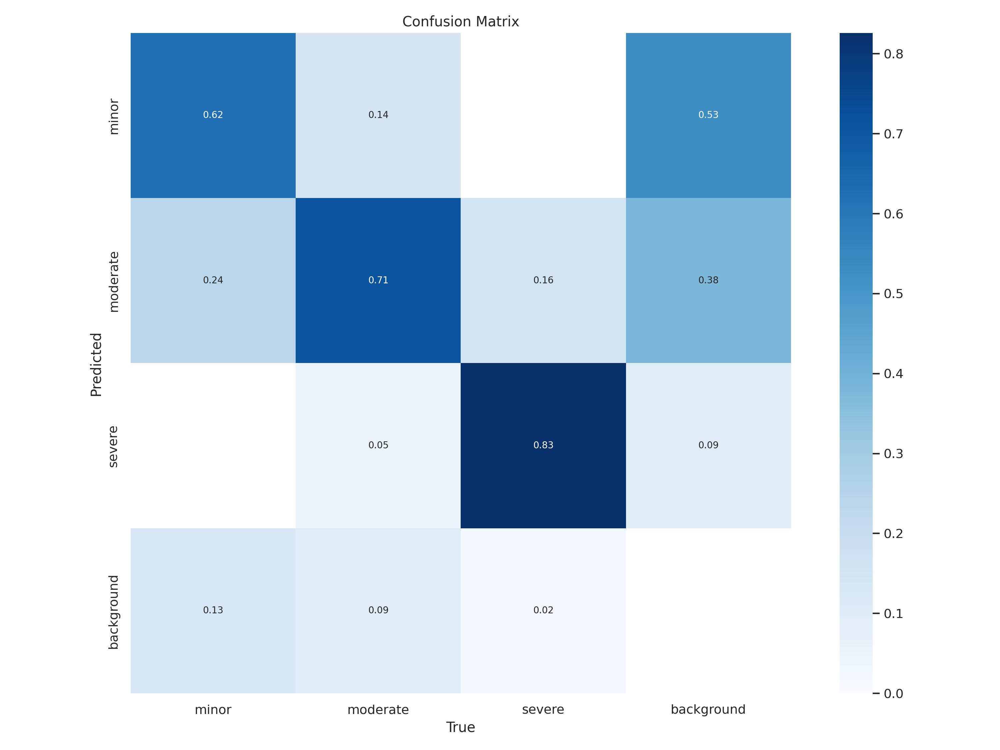

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train/confusion_matrix.png', width=600)

/content


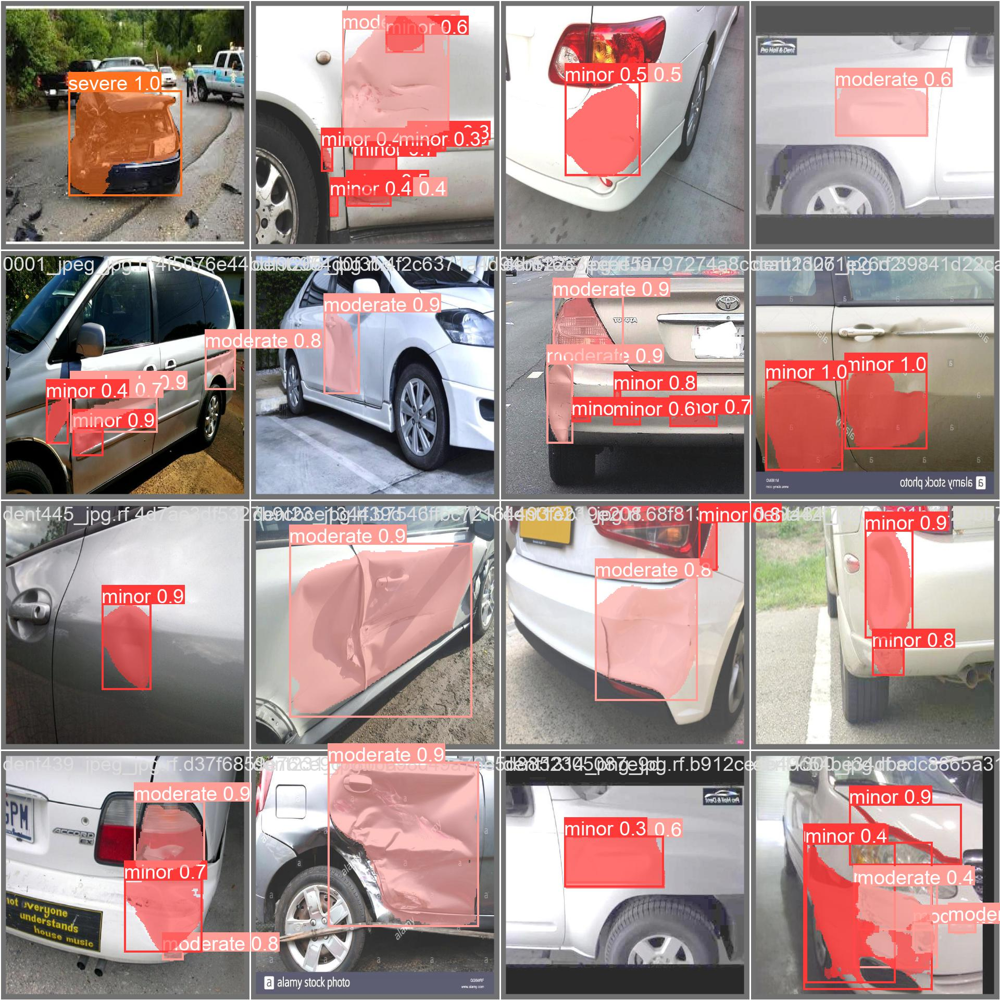

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train/val_batch0_pred.jpg', width=1000)

In [ ]:
%cd {HOME}

!yolo task=segment mode=val model={HOME}/runs/segment/train/weights/best.pt data=car_damage_dataset/YoloV8_format/severe_damage/data.yaml

/content
2023-05-05 15:26:20.552587: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-05 15:26:21.518273: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.20 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11780761 parameters, 0 gradients, 42.4 GFLOPs
val: Scanning /content/car_damage_dataset/YoloV8_format/severe_damage/valid/labels.cache... 494 images, 0 backgrounds, 0 corrupt: 100% 494/494 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 31/31 [00:11<00:00,  2.75it/s]
                   all        494        837      0

In [ ]:
%cd {HOME}
!yolo task=segment mode=predict model={HOME}/runs/segment/train/weights/best.pt conf=0.25 source=/content/car_damage_dataset/YoloV8_format/severe_damage/test/images save=true

/content
2023-05-05 15:26:39.287596: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/segment/predict/*.jpg'):
      display(Image(filename=image_path, height=600))
      print("\n")

## with augmented data

In [ ]:
%cd {HOME}

!yolo task=segment mode=train model=yolov8m-seg.pt data=car_damage_dataset/YoloV8_format/severe_damage_augmented/data.yaml epochs=100 imgsz=640

/content
100% 52.4M/52.4M [00:00<00:00, 82.7MB/s]

Ultralytics YOLOv8.0.20 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=segment, mode=train, model=yolov8m-seg.yaml, data=car_damage_dataset/YoloV8_format/severe_damage_augmented/data.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, cache=False, device=, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=False, val=True, save_json=False, save_hybrid=False, conf=0.001, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=ultralytics/assets/, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=Tru

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train/confusion_matrix.png', width=600)

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train/val_batch0_pred.jpg', width=1000)

In [ ]:
%cd {HOME}

!yolo task=segment mode=val model={HOME}/runs/segment/train/weights/best.pt data=car_damage_dataset/YoloV8_format/severe_damage_augmented/data.yaml

[Errno 2] No such file or directory: '{HOME}'
/content
/bin/bash: yolo: command not found


In [ ]:
%cd {HOME}
!yolo task=segment mode=predict model={HOME}/runs/segment/train/weights/best.pt conf=0.25 source=/content/car_damage_dataset/YoloV8_format/severe_damage_augmented/test/images save=true

[Errno 2] No such file or directory: '{HOME}'
/content
/bin/bash: yolo: command not found


In [ ]:
os.chdir("/content")

NameError: ignored

In [ ]:
shutil.make_archive('YOLOV8_damage_severity_segmentation', 'zip', root_dir='/content/runs')

In [ ]:
shutil.copy("/content/YOLOV8_damage_severity_segmentation.zip", "/content/drive/MyDrive/GT-AI: Datasets+Notebooks/Datasets/Cars/Computer Vision/Car_damage/")

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/segment/predict/*.jpg'):
      display(Image(filename=image_path, height=600))
      print("\n")

In [ ]:
shutil.rmtree("/content/runs")

## **Car damage detection**

#### **YoloV5**

In [ ]:
os.mkdir("/content/car_damage_dataset/YoloV5_format")

In [ ]:
extract_csv("/content/drive/MyDrive/GT-AI: Datasets+Notebooks/Datasets/Cars/Computer Vision/Car_damage/car damage v2 yolov5.zip", "/content/car_damage_dataset/YoloV5_format")

In [ ]:
os.chdir("/content")

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt  # install

import torch
import utils
display = utils.notebook_init()  # checks

YOLOv5 🚀 v7.0-151-g3e14883 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 23.9/78.2 GB disk)


In [ ]:
with open("/content/yolov5/data/data.yaml","a") as file:
    file.write("train: /content/car_damage_dataset/YoloV5_format/train/images \n")
    file.write("val: /content/car_damage_dataset/YoloV5_format/valid/images \n")
    file.write("test: /content/car_damage_dataset/YoloV5_format/test/images \n")
    file.write("\n")
    file.write("is_coco: False \n")
    file.write("\n")
    file.write("nc: 1 \n")
    file.write("names: ['damage'] \n")

In [ ]:
!python train.py --img 640 --batch 16 --epochs 100 --data data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-151-g3e14883 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, a

In [ ]:
! python val.py --data data.yaml --weights runs/train/exp/weights/best.pt --task test

val: data=/content/yolov5/data/data.yaml, weights=['runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-151-g3e14883 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning /content/car_damage_dataset/YoloV5_format/test/labels... 295 images, 0 backgrounds, 0 corrupt: 100% 295/295 [00:00<00:00, 617.15it/s]
test: New cache created: /content/car_damage_dataset/YoloV5_format/test/labels.cache
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 10/10 [00:09<00:00,  1.09it/s]
                   all   

In [ ]:
! python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.1 --source /content/car_damage_dataset/YoloV5_format/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/car_damage_dataset/YoloV5_format/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-151-g3e14883 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/295 /content/car_damage_dataset/YoloV5_format/test/images/1005_jpeg_jpg.rf.ae01319b3d2bb3c9d8816f4c6751b7d8.jpg: 640x640 1 damage, 11.5ms
image 2/295 /content/car_damage_dataset/YoloV5_format/test/images/1009_jpeg_jpg.rf.5687d9cdc1d2ecaf7d4e

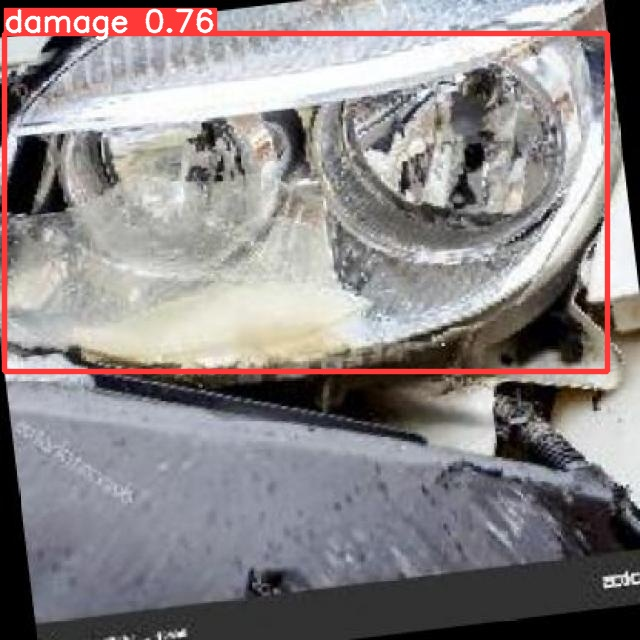

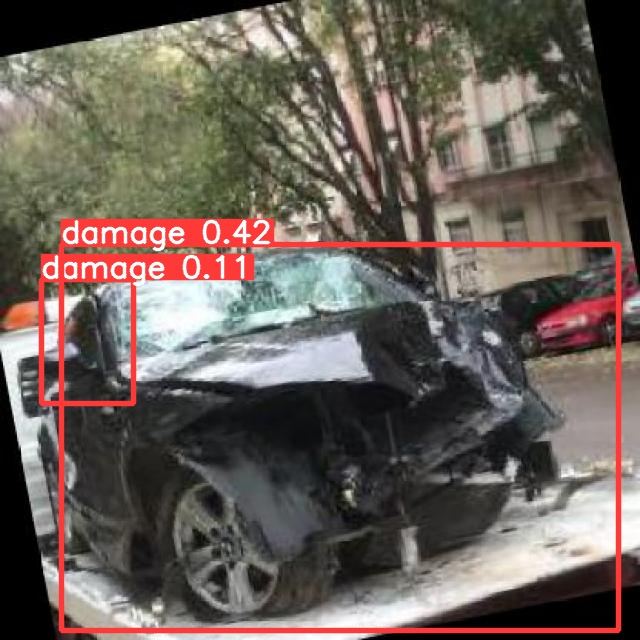

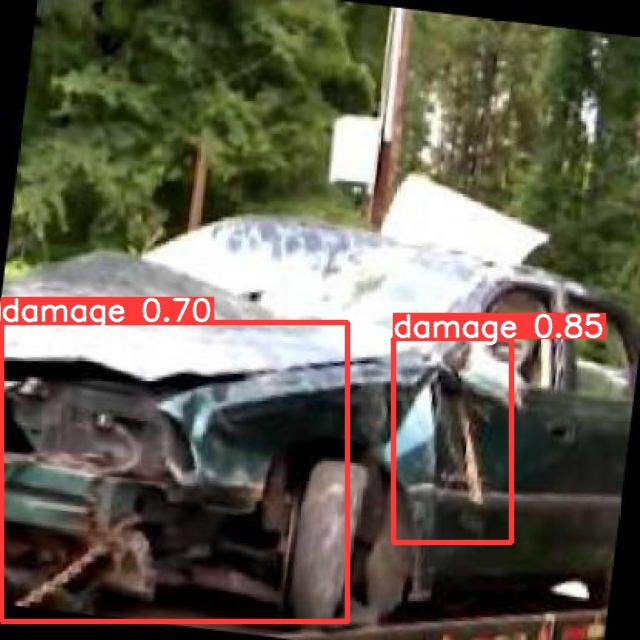

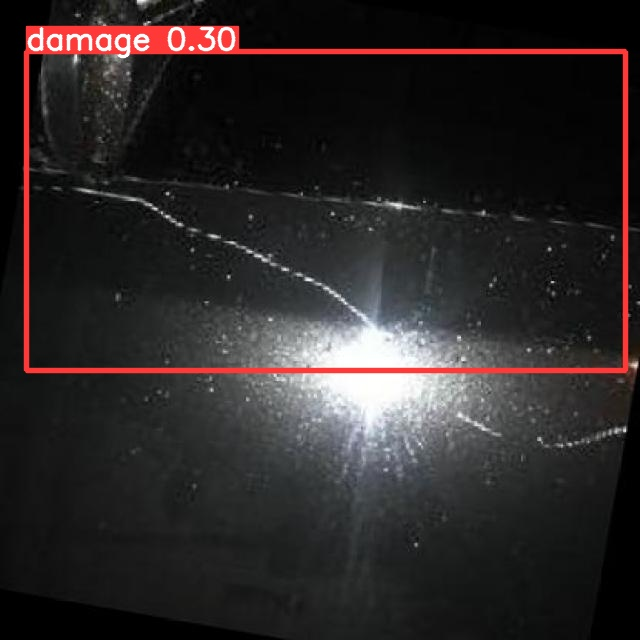

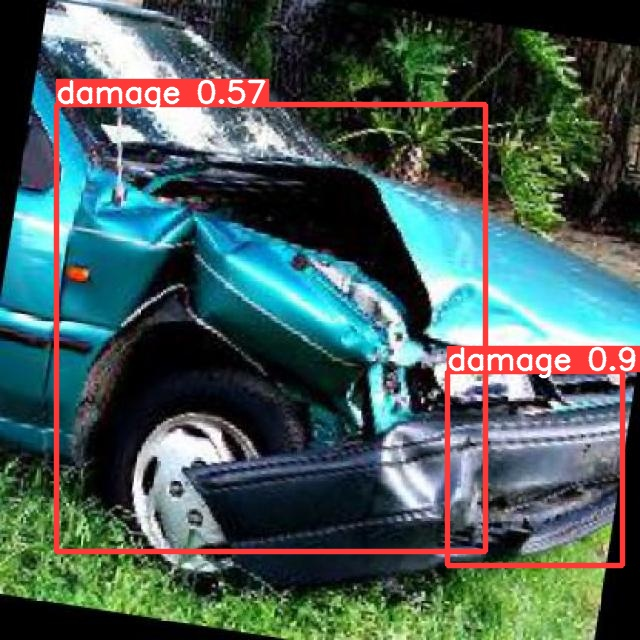

...

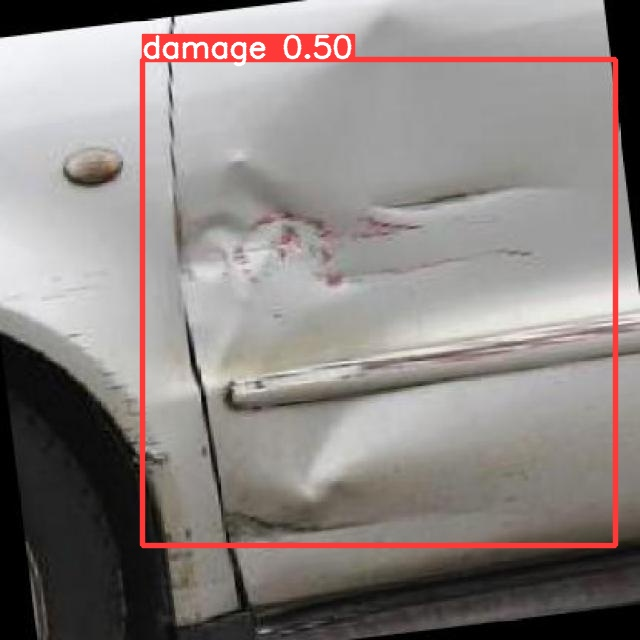

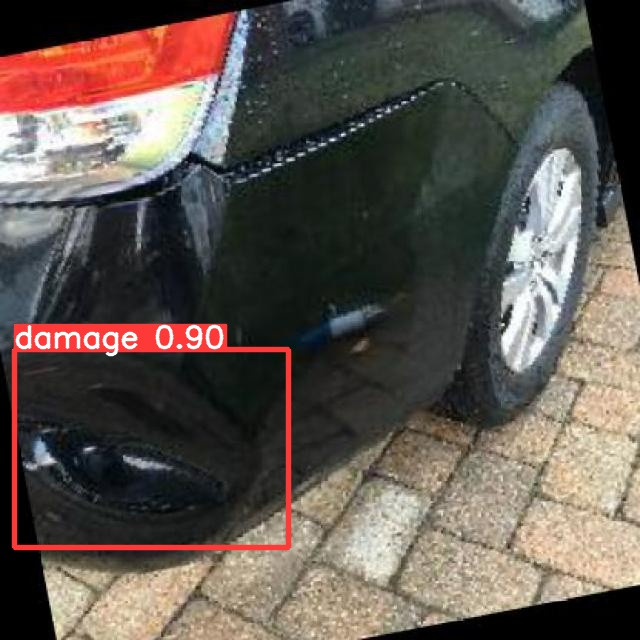

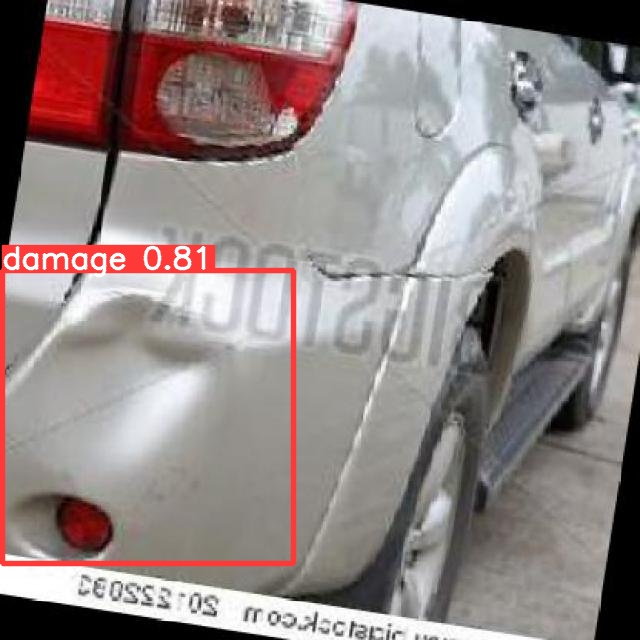

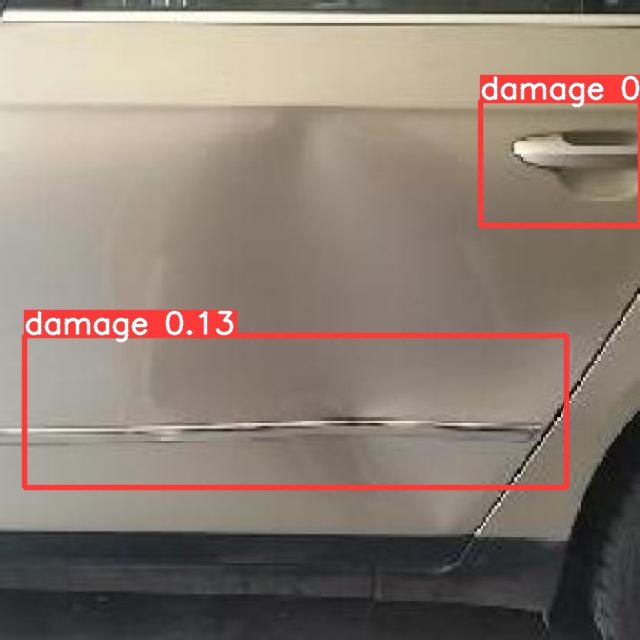

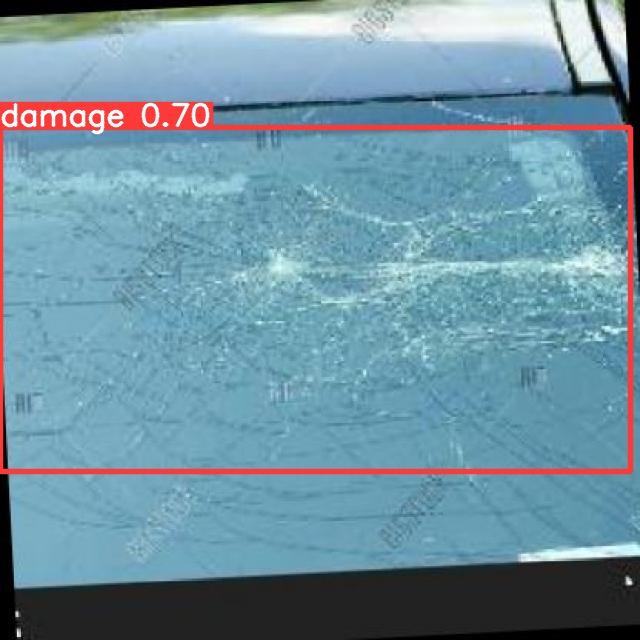

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp3/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

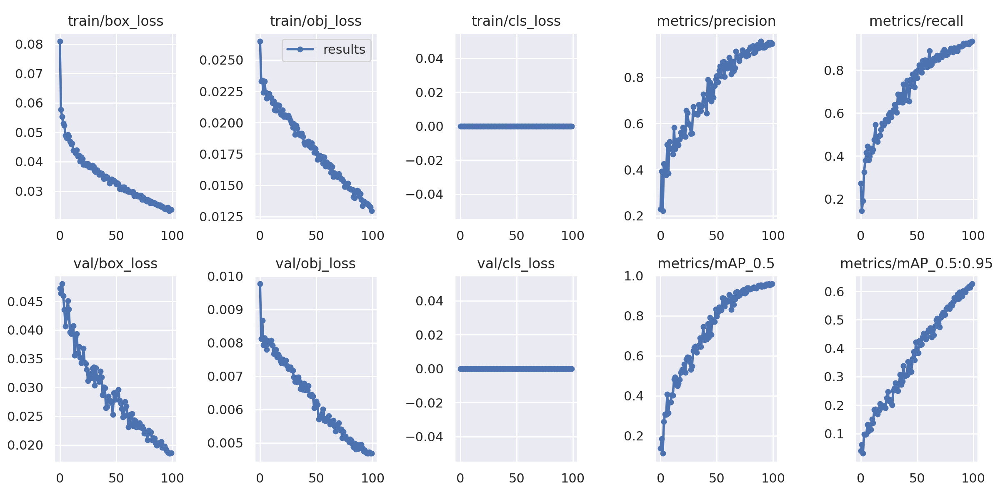

In [ ]:
Image(filename='/content/yolov5/runs/train/exp/results.png', width=1000)

#### Zipping folder

In [ ]:
os.chdir("/content")

In [ ]:
shutil.make_archive('YOLOV5_damage_detection', 'zip', root_dir='/content/yolov5')

'/content/YOLOV5_damage_detection.zip'

In [ ]:
shutil.copy("/content/YOLOV5_damage_detection.zip", "/content/drive/MyDrive/GT-AI: Datasets+Notebooks/Datasets/Cars/Computer Vision/Car_damage/")

'/content/drive/MyDrive/GT-AI: Datasets+Notebooks/Datasets/Cars/Computer Vision/Car_damage/YOLOV5_damage_detection.zip'